In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import random, tqdm
import cv2

In [21]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.autograd import Variable

In [3]:
!pip install -U git+https://github.com/albu/albumentations --no-cache-dir > /dev/null

  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-r8_4n53v


In [4]:
import albumentations as album

In [5]:
def th_flatten(a):
    """Flatten tensor"""
    return a.contiguous().view(a.nelement())


def th_repeat(a, repeats, axis=0):
    """Torch version of np.repeat for 1D"""
    assert len(a.size()) == 1
    return th_flatten(torch.transpose(a.repeat(repeats, 1), 0, 1))


def np_repeat_2d(a, repeats):
    """Tensorflow version of np.repeat for 2D"""

    assert len(a.shape) == 2
    a = np.expand_dims(a, 0)
    a = np.tile(a, [repeats, 1, 1])
    return a


def th_gather_2d(input, coords):
    inds = coords[:, 0]*input.size(1) + coords[:, 1]
    x = torch.index_select(th_flatten(input), 0, inds)
    return x.view(coords.size(0))


def th_map_coordinates(input, coords, order=1):
    """Tensorflow verion of scipy.ndimage.map_coordinates
    Note that coords is transposed and only 2D is supported
    Parameters
    ----------
    input : tf.Tensor. shape = (s, s)
    coords : tf.Tensor. shape = (n_points, 2)
    """

    assert order == 1
    input_size = input.size(0)

    coords = torch.clamp(coords, 0, input_size - 1)
    coords_lt = coords.floor().long()
    coords_rb = coords.ceil().long()
    coords_lb = torch.stack([coords_lt[:, 0], coords_rb[:, 1]], 1)
    coords_rt = torch.stack([coords_rb[:, 0], coords_lt[:, 1]], 1)

    vals_lt = th_gather_2d(input,  coords_lt.detach())
    vals_rb = th_gather_2d(input,  coords_rb.detach())
    vals_lb = th_gather_2d(input,  coords_lb.detach())
    vals_rt = th_gather_2d(input,  coords_rt.detach())

    coords_offset_lt = coords - coords_lt.type(coords.data.type())

    vals_t = vals_lt + (vals_rt - vals_lt) * coords_offset_lt[:, 0]
    vals_b = vals_lb + (vals_rb - vals_lb) * coords_offset_lt[:, 0]
    mapped_vals = vals_t + (vals_b - vals_t) * coords_offset_lt[:, 1]
    return mapped_vals


def sp_batch_map_coordinates(inputs, coords):
    """Reference implementation for batch_map_coordinates"""
    # coords = coords.clip(0, inputs.shape[1] - 1)

    assert (coords.shape[2] == 2)
    height = coords[:,:,0].clip(0, inputs.shape[1] - 1)
    width = coords[:,:,1].clip(0, inputs.shape[2] - 1)
    np.concatenate((np.expand_dims(height, axis=2), np.expand_dims(width, axis=2)), 2)

    mapped_vals = np.array([
        sp_map_coordinates(input, coord.T, mode='nearest', order=1)
        for input, coord in zip(inputs, coords)
    ])
    return mapped_vals


def th_batch_map_coordinates(input, coords, order=1):
    """Batch version of th_map_coordinates
    Only supports 2D feature maps
    Parameters
    ----------
    input : tf.Tensor. shape = (b, s, s)
    coords : tf.Tensor. shape = (b, n_points, 2)
    Returns
    -------
    tf.Tensor. shape = (b, s, s)
    """

    batch_size = input.size(0)
    input_height = input.size(1)
    input_width = input.size(2)

    n_coords = coords.size(1)

    # coords = torch.clamp(coords, 0, input_size - 1)

    coords = torch.cat((torch.clamp(coords.narrow(2, 0, 1), 0, input_height - 1), torch.clamp(coords.narrow(2, 1, 1), 0, input_width - 1)), 2)

    assert (coords.size(1) == n_coords)

    coords_lt = coords.floor().long()
    coords_rb = coords.ceil().long()
    coords_lb = torch.stack([coords_lt[..., 0], coords_rb[..., 1]], 2)
    coords_rt = torch.stack([coords_rb[..., 0], coords_lt[..., 1]], 2)
    idx = th_repeat(torch.arange(0, batch_size), n_coords).long()
    idx = Variable(idx, requires_grad=False)
    if input.is_cuda:
        idx = idx.cuda()

    def _get_vals_by_coords(input, coords):
        indices = torch.stack([
            idx, th_flatten(coords[..., 0]), th_flatten(coords[..., 1])
        ], 1)
        inds = indices[:, 0]*input.size(1)*input.size(2)+ indices[:, 1]*input.size(2) + indices[:, 2]
        vals = th_flatten(input).index_select(0, inds)
        vals = vals.view(batch_size, n_coords)
        return vals

    vals_lt = _get_vals_by_coords(input, coords_lt.detach())
    vals_rb = _get_vals_by_coords(input, coords_rb.detach())
    vals_lb = _get_vals_by_coords(input, coords_lb.detach())
    vals_rt = _get_vals_by_coords(input, coords_rt.detach())

    coords_offset_lt = coords - coords_lt.type(coords.data.type())
    vals_t = coords_offset_lt[..., 0]*(vals_rt - vals_lt) + vals_lt
    vals_b = coords_offset_lt[..., 0]*(vals_rb - vals_lb) + vals_lb
    mapped_vals = coords_offset_lt[..., 1]* (vals_b - vals_t) + vals_t
    return mapped_vals


def sp_batch_map_offsets(input, offsets):
    """Reference implementation for tf_batch_map_offsets"""

    batch_size = input.shape[0]
    input_height = input.shape[1]
    input_width = input.shape[2]

    offsets = offsets.reshape(batch_size, -1, 2)
    grid = np.stack(np.mgrid[:input_height, :input_width], -1).reshape(-1, 2)
    grid = np.repeat([grid], batch_size, axis=0)
    coords = offsets + grid
    # coords = coords.clip(0, input_size - 1)

    mapped_vals = sp_batch_map_coordinates(input, coords)
    return mapped_vals


def th_generate_grid(batch_size, input_height, input_width, dtype, cuda):
    grid = np.meshgrid(
        range(input_height), range(input_width), indexing='ij'
    )
    grid = np.stack(grid, axis=-1)
    grid = grid.reshape(-1, 2)

    grid = np_repeat_2d(grid, batch_size)
    grid = torch.from_numpy(grid).type(dtype)
    if cuda:
        grid = grid.cuda()
    return Variable(grid, requires_grad=False)


def th_batch_map_offsets(input, offsets, grid=None, order=1):
    """Batch map offsets into input
    Parameters
    ---------
    input : torch.Tensor. shape = (b, s, s)
    offsets: torch.Tensor. shape = (b, s, s, 2)
    Returns
    -------
    torch.Tensor. shape = (b, s, s)
    """
    batch_size = input.size(0)
    input_height = input.size(1)
    input_width = input.size(2)

    offsets = offsets.view(batch_size, -1, 2)
    if grid is None:
        grid = th_generate_grid(batch_size, input_height, input_width, offsets.data.type(), offsets.data.is_cuda)

    coords = offsets + grid

    mapped_vals = th_batch_map_coordinates(input, coords)
    return mapped_vals

In [6]:
## Deformable Convaolution
class ConvOffset2D(nn.Conv2d):
    """ConvOffset2D
    Convolutional layer responsible for learning the 2D offsets and output the
    deformed feature map using bilinear interpolation
    Note that this layer does not perform convolution on the deformed feature
    map. See get_deform_cnn in cnn.py for usage
    """
    def __init__(self, filters, init_normal_stddev=0.01, **kwargs):
        """Init
        Parameters
        ----------
        filters : int
            Number of channel of the input feature map
        init_normal_stddev : float
            Normal kernel initialization
        **kwargs:
            Pass to superclass. See Con2d layer in pytorch
        """
        self.filters = filters
        self._grid_param = None
        super(ConvOffset2D, self).__init__(self.filters, self.filters*2, 3, padding=1, bias=False, **kwargs)
        self.weight.data.copy_(self._init_weights(self.weight, init_normal_stddev))

    def forward(self, x):
        """Return the deformed featured map"""
        x_shape = x.size()
        offsets = super(ConvOffset2D, self).forward(x)

        # offsets: (b*c, h, w, 2)
        offsets = self._to_bc_h_w_2(offsets, x_shape)

        # x: (b*c, h, w)
        x = self._to_bc_h_w(x, x_shape)

        # X_offset: (b*c, h, w)
        x_offset = th_batch_map_offsets(x, offsets, grid=self._get_grid(self,x))

        # x_offset: (b, h, w, c)
        x_offset = self._to_b_c_h_w(x_offset, x_shape)

        return x_offset

    @staticmethod
    def _get_grid(self, x):
        batch_size, input_height, input_width = x.size(0), x.size(1), x.size(2)
        dtype, cuda = x.data.type(), x.data.is_cuda
        if self._grid_param == (batch_size, input_height, input_width, dtype, cuda):
            return self._grid
        self._grid_param = (batch_size, input_height, input_width, dtype, cuda)
        self._grid = th_generate_grid(batch_size, input_height, input_width, dtype, cuda)
        return self._grid

    @staticmethod
    def _init_weights(weights, std):
        fan_out = weights.size(0)
        fan_in = weights.size(1) * weights.size(2) * weights.size(3)
        w = np.random.normal(0.0, std, (fan_out, fan_in))
        return torch.from_numpy(w.reshape(weights.size()))

    @staticmethod
    def _to_bc_h_w_2(x, x_shape):
        """(b, 2c, h, w) -> (b*c, h, w, 2)"""
        x = x.contiguous().view(-1, int(x_shape[2]), int(x_shape[3]), 2)
        return x

    @staticmethod
    def _to_bc_h_w(x, x_shape):
        """(b, c, h, w) -> (b*c, h, w)"""
        x = x.contiguous().view(-1, int(x_shape[2]), int(x_shape[3]))
        return x

    @staticmethod
    def _to_b_c_h_w(x, x_shape):
        """(b*c, h, w) -> (b, c, h, w)"""
        x = x.contiguous().view(-1, int(x_shape[1]), int(x_shape[2]), int(x_shape[3]))
        return x

In [7]:
!pip install -q -U segmentation-models-pytorch albumentations > /dev/null
import segmentation_models_pytorch as smp

In [8]:
from skimage.color import rgb2gray

In [9]:
DATA_DIR = '/content/drive/MyDrive/BTP/ChangeDataset'

x_train_dir_a = os.path.join(DATA_DIR, 'train/A')
x_train_dir_b = os.path.join(DATA_DIR, 'train/B')
y_train_dir = os.path.join(DATA_DIR, 'train/label')

x_val_dir_a = os.path.join(DATA_DIR, 'val/A')
x_val_dir_b = os.path.join(DATA_DIR, 'val/B')
y_val_dir = os.path.join(DATA_DIR, 'val/label')

x_test_dir_a = os.path.join(DATA_DIR, 'test/A')
x_test_dir_b = os.path.join(DATA_DIR, 'test/B')
y_test_dir = os.path.join(DATA_DIR, 'test/label')

In [10]:
class_names = ['background', 'foreground']
class_rgb_values = [[0, 0, 0], [255, 255, 255]]
# Useful to shortlist specific classes in datasets with large number of classes
select_classes = ['background', 'foreground']

# Get RGB values of required classes
select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Selected classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Selected classes and their corresponding RGB values in labels:
Class Names:  ['background', 'foreground']
Class RGB values:  [[0, 0, 0], [255, 255, 255]]


In [11]:
# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]); 
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Perform one hot encoding on label
def one_hot_encode(label, label_values):
    """
    Convert a segmentation image label array to one-hot format
    by replacing each pixel value with a vector of length num_classes
    # Arguments
        label: The 2D array segmentation image label
        label_values
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of num_classes
    """
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map
    
# Perform reverse one-hot-encoding on labels / preds
def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image 
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified 
        class key.
    """
    x = np.argmax(image, axis = -1)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x

In [12]:
class ChangeDataset(torch.utils.data.Dataset):

    def __init__(
        self, 
        images_a_dir, 
        images_b_dir,
        labels_dir,
        size=None,
        class_rgb_values=None,
        augmentation=None,
        preprocessing=None
    ):
        self.image_a_paths = [os.path.join(images_a_dir, image_id) for image_id in sorted(os.listdir(images_a_dir))][:size]
        self.image_b_paths = [os.path.join(images_b_dir, image_id) for image_id in sorted(os.listdir(images_b_dir))][:size]
        self.label_paths = [os.path.join(labels_dir, image_id) for image_id in sorted(os.listdir(labels_dir))][:size]

        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    def __getitem__(self, i):
        
        # read images and masks
        image_a = cv2.cvtColor(cv2.imread(self.image_a_paths[i]), cv2.COLOR_BGR2RGB)
        image_b = cv2.cvtColor(cv2.imread(self.image_b_paths[i]), cv2.COLOR_BGR2RGB)
        label = cv2.cvtColor(cv2.imread(self.label_paths[i]), cv2.COLOR_BGR2RGB)
        image = image_a-image_b
        # one-hot-encode the mask
        mask = one_hot_encode(label, self.class_rgb_values).astype('float')
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
    
    def __len__(self):
        # return length of 
        return len(self.image_a_paths)


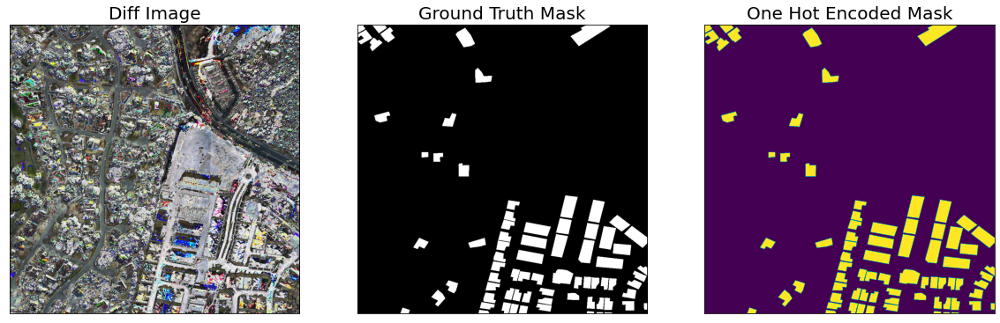

In [13]:
dataset = ChangeDataset(x_train_dir_a, x_train_dir_b, y_train_dir, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[2]

visualize(
    diff_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [14]:
def get_training_augmentation():
    train_transform = [    
        album.RandomCrop(height=256, width=256, always_apply=True),
        album.OneOf(
            [
                album.HorizontalFlip(p=1),
                album.VerticalFlip(p=1),
                album.RandomRotate90(p=1),
            ],
            p=0.75,
        ),
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():   
    # Add sufficient padding to ensure image is divisible by 32
    test_transform = [
        album.PadIfNeeded(min_height=1536, min_width=1536, always_apply=True, border_mode=0),
    ]
    return album.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    """Construct preprocessing transform    
    Args:
        preprocessing_fn (callable): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    """   
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))
        
    return album.Compose(_transform)

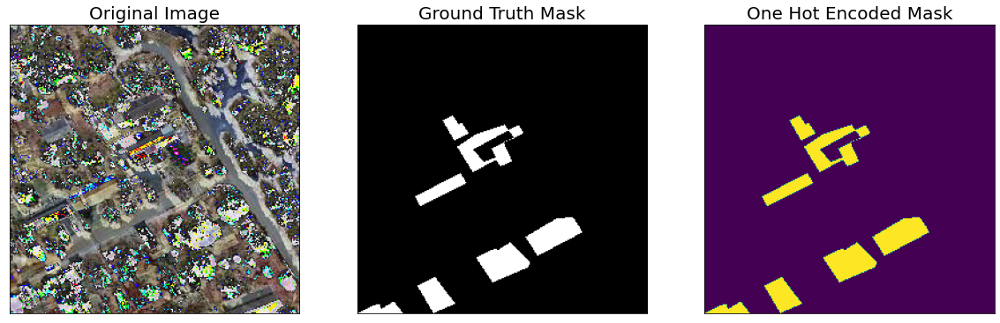

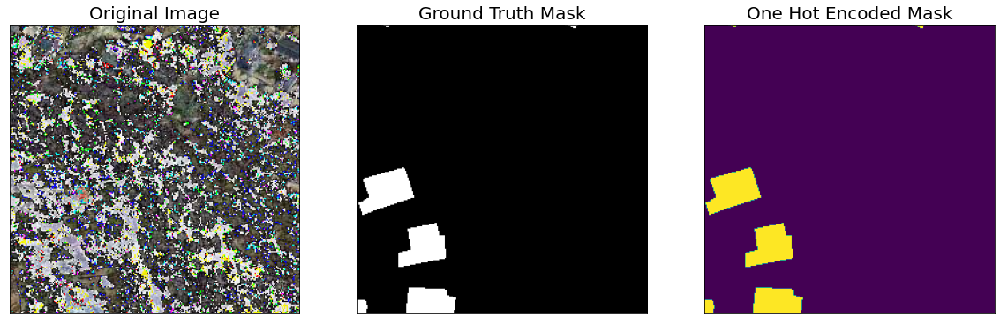

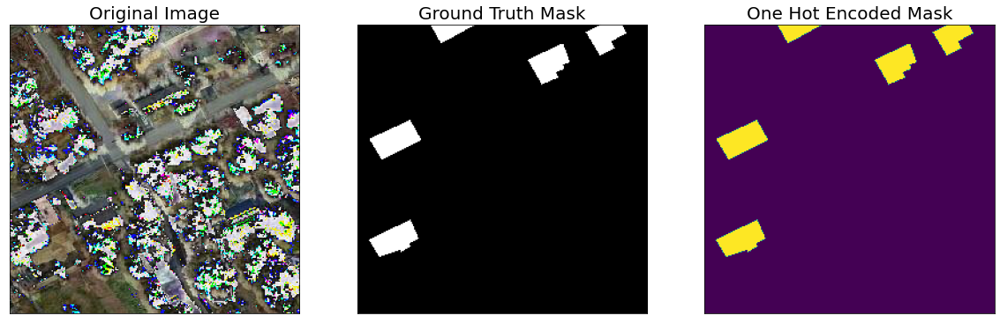

In [15]:
augmented_dataset = ChangeDataset(
    x_train_dir_a, x_train_dir_b, y_train_dir, 
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on a random image/mask pair (256*256 crop)
for i in range(3):
    image, mask = augmented_dataset[random_idx]
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

In [16]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = select_classes
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.Unet(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [23]:
# Get train and val dataset instances
train_dataset = ChangeDataset(
    x_train_dir_a, x_train_dir_b, y_train_dir, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values
)

valid_dataset = ChangeDataset(
    x_val_dir_a, x_val_dir_b, y_val_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values
)

# Get train and val data loaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=2)

In [24]:
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 5

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()

# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

# define optimizer
optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.00008),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
# if os.path.exists('../input/unet-resnet50-frontend-road-segmentation-pytorch/best_model.pth'):
#     model = torch.load('../input/unet-resnet50-frontend-road-segmentation-pytorch/best_model.pth', map_location=DEVICE)

In [25]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [27]:
%%time

if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, '/content/drive/MyDrive/BTP/change_diff_best_model.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 64/64 [00:52<00:00,  1.22it/s, dice_loss - 0.5562, iou_score - 0.3912]
Model saved!

Epoch: 1
valid: 100%|██████████| 64/64 [00:52<00:00,  1.23it/s, dice_loss - 0.5399, iou_score - 0.3951]
Model saved!

Epoch: 2
valid: 100%|██████████| 64/64 [00:52<00:00,  1.23it/s, dice_loss - 0.5177, iou_score - 0.4189]
Model saved!

Epoch: 3
valid: 100%|██████████| 64/64 [00:52<00:00,  1.23it/s, dice_loss - 0.5299, iou_score - 0.4013]

Epoch: 4
valid: 100%|██████████| 64/64 [00:52<00:00,  1.23it/s, dice_loss - 0.5156, iou_score - 0.4175]
CPU times: user 4min 55s, sys: 44.3 s, total: 5min 39s
Wall time: 9min 19s


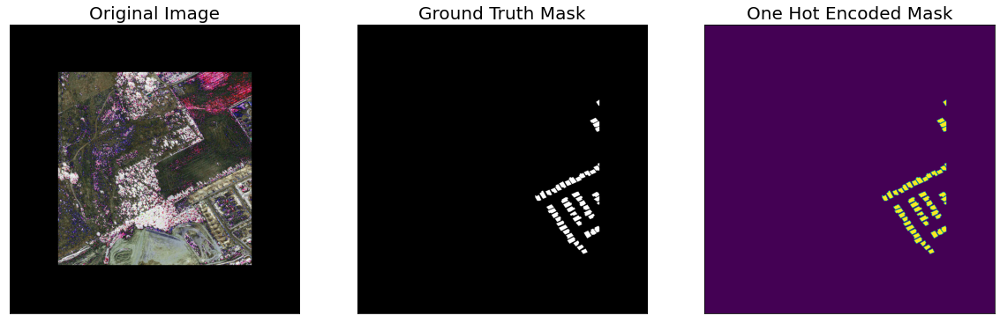

In [29]:
# create test dataloader to be used with UNet model (with preprocessing operation: to_tensor(...))
test_dataset = ChangeDataset(
    x_test_dir_a, x_test_dir_b, y_test_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

test_dataloader = DataLoader(test_dataset)

# test dataset for visualization (without preprocessing transformations)
test_dataset_vis = ChangeDataset(
    x_test_dir_a, x_test_dir_b, y_test_dir, 
    augmentation=get_validation_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

# get a random test image/mask index
random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

# Notice the images / masks are 1536*1536 because of 18px padding on all sides. 
# This is to ensure the input image dimensions to UNet model are a multiple of 2 (to account for pooling & transpose conv. operations).

In [30]:
# Center crop padded image / mask to original image dims
def crop_image(image, target_image_dims=[1500,1500,3]):
   
    target_size = target_image_dims[0]
    image_size = len(image)
    padding = (image_size - target_size) // 2

    if padding<0:
        return image

    return image[
        padding:image_size - padding,
        padding:image_size - padding,
        :,
    ]

In [33]:
if os.path.exists('/content/drive/MyDrive/BTP/change_diff_best_model.pth'):
    best_model = torch.load('/content/drive/MyDrive/BTP/change_diff_best_model.pth', map_location=DEVICE)
    print('Loaded UNet model from this run.')

Loaded UNet model from this run.


In [34]:
sample_preds_folder = '/content/drive/MyDrive/BTP/changePreds'
if not os.path.exists(sample_preds_folder):
    os.makedirs(sample_preds_folder)

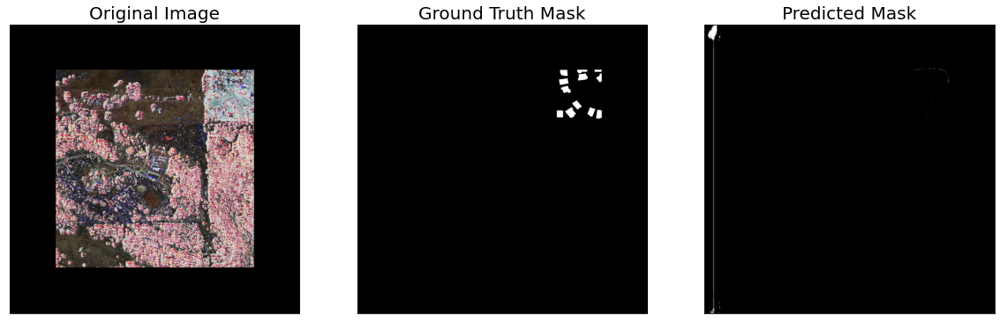

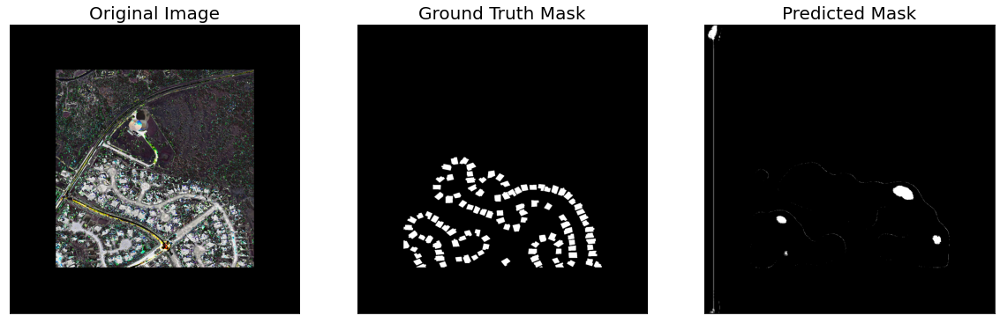

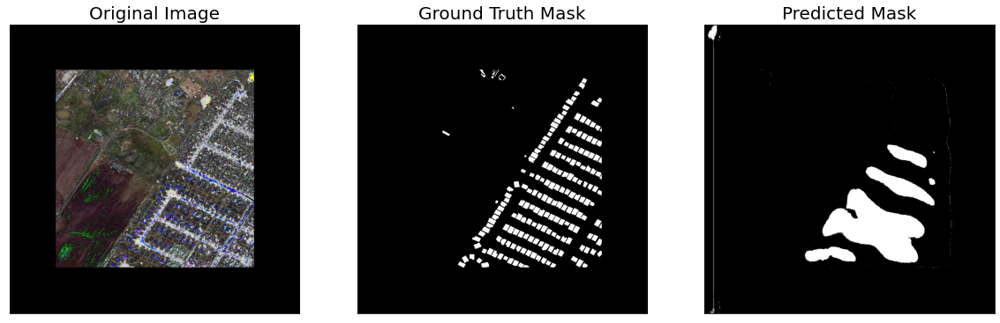

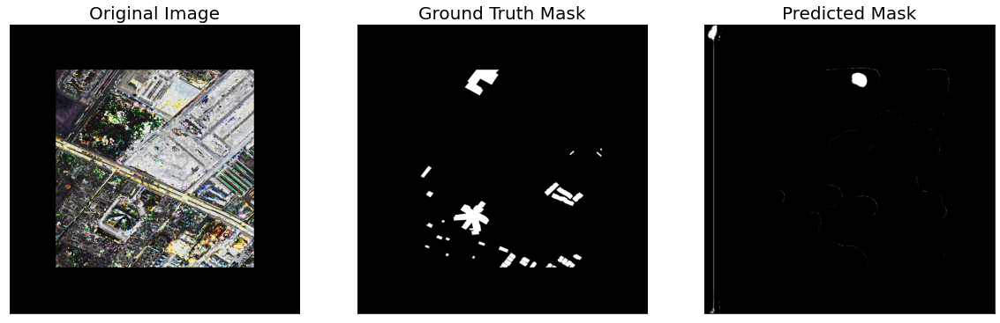

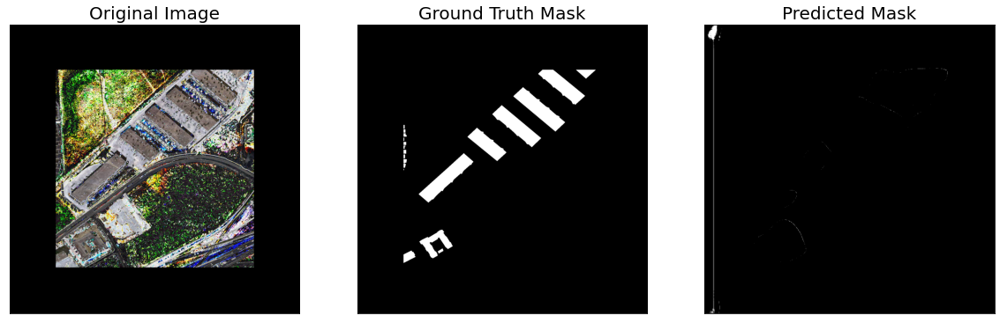

...

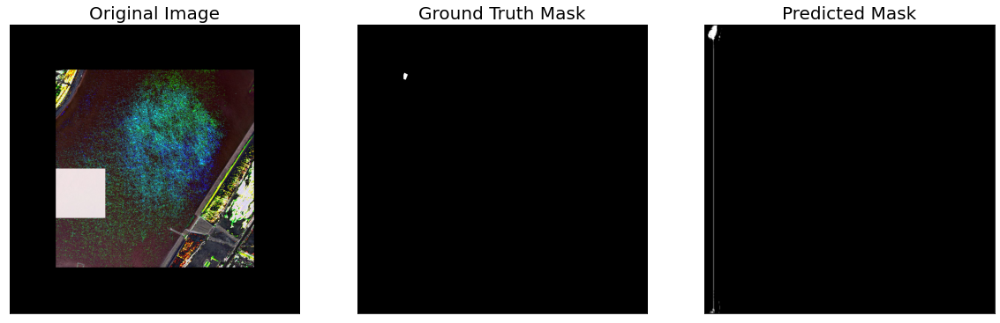

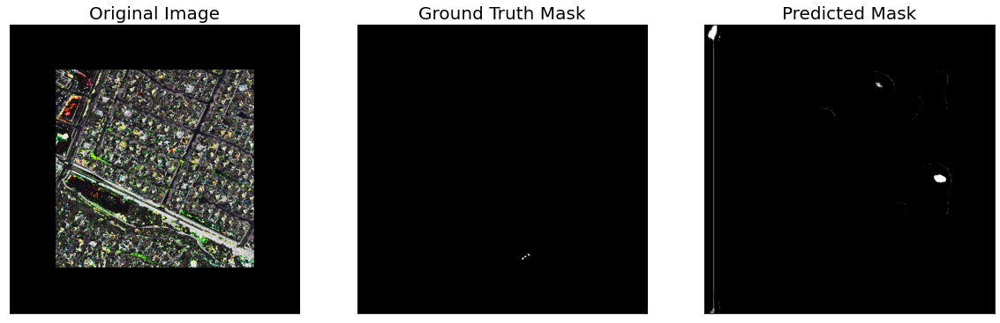

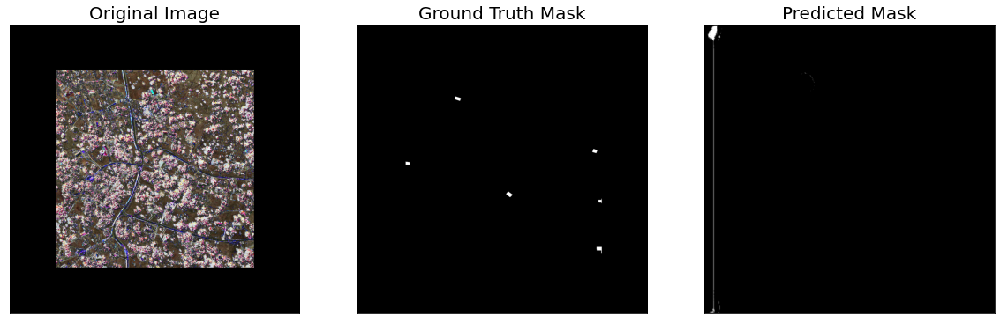

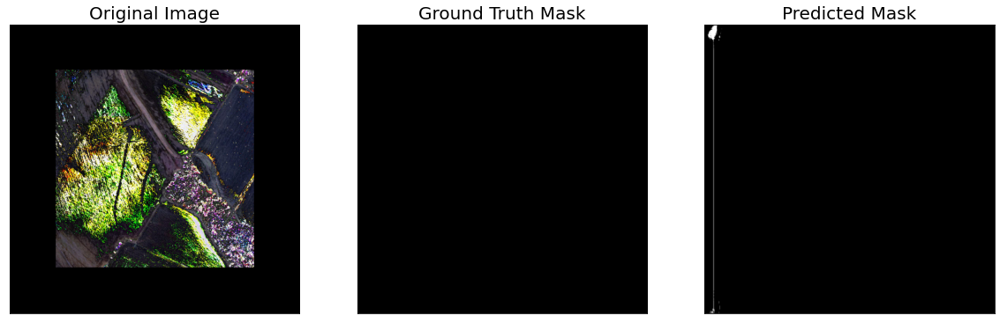

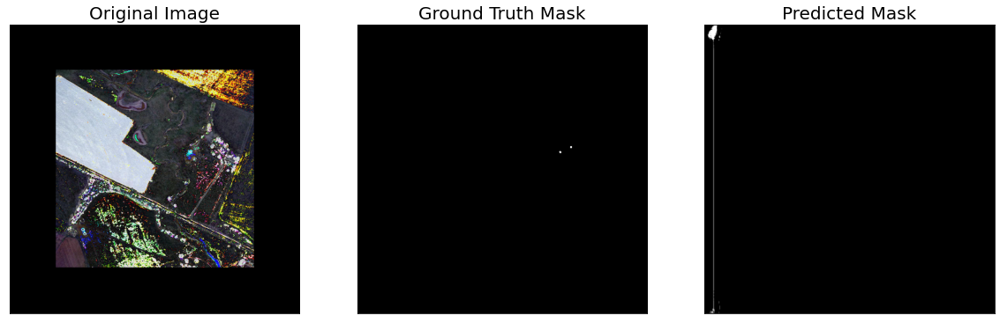

KeyboardInterrupt: ignored

In [36]:
import pickle
res = {}
res['image'] = []
res['gt'] = []
res['heatmap'] = []
res['pred'] = []

for idx in range(len(test_dataset)):

    image, gt_mask = test_dataset[idx]
    image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask,(1,2,0))
    # Get prediction channel corresponding to road
    pred_road_heatmap = pred_mask[:,:,select_classes.index('foreground')]
    pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
#     crfres = getCRFMap(pred_road_heatmap, image.astype('uint8'))
    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    ########
#     res['image'].append(image_vis)
#     res['gt'].append(gt_mask)
#     res['heatmap'].append(pred_road_heatmap)
#     res['pred'].append(pred_mask)
    
    ########
    visualize(
        original_image = image_vis,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask
    )
    
# with open('data_3.pb', 'wb') as f:
#     pickle.dump(res, f, pickle.HIGHEST_PROTOCOL)